In [136]:
%matplotlib inline


import h5py
import numpy as np
from matplotlib import pyplot as plt 


   
  # READ IN H5PY COMPRESSED READS FILES

info:
    
readfile1:  150415_SN651_0372_AH3N2YBCXX/Sample_H_L_M1_1 --> Mi1_d1-rep1-2015

readifle2:  150415_SN651_0372_AH3N2YBCXX/Sample_H_L_M2_1 --> Mi1_d1-rep2-2015

readfile3:  150415_SN651_0372_AH3N2YBCXX/Sample_H_L_M3_1 --> Tm3_d1-rep1-2015

In [139]:
readfile1 = h5py.File('examples/150415_SN651_0372_AH3N2YBCXX__Sample_H_L_M1_1Aligned_chr4.h5','r')
reads1 = readfile1.get('reads')[()]

In [140]:
readfile2 = h5py.File('examples/150415_SN651_0372_AH3N2YBCXX__Sample_H_L_M2_1Aligned_chr4.h5','r')
reads2 = readfile2.get('reads')[()]

In [141]:
readfile3 = h5py.File('examples/150415_SN651_0372_AH3N2YBCXX__Sample_H_L_M3_1Aligned_chr4.h5','r')
reads3 = readfile3.get('reads')[()]

In [142]:
#take slices:

def sliceidxing(reads, low, high):
    if low < 0:
        l = 0
    else:
        l = low
    if high > len(reads):
        h = len(reads)
    else: 
        h = high
    
    sliced = reads[l:h]
    idx = range(len(sliced))
    
    arr = np.stack((idx,sliced))
    arr = sliced
    return arr
    
    

In [143]:
lowtest = 552000
hightest = 554000

In [144]:
lowtest = 500
hightest = 10000

In [145]:
len(reads1)/10

134813

In [146]:
stuff = sliceidxing(reads1, lowtest, hightest)

In [147]:
stuff2 = sliceidxing(reads2, lowtest, hightest)

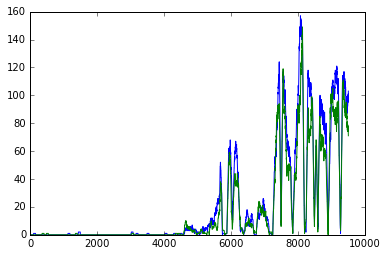

In [148]:

plt.plot(stuff.T)
plt.plot(stuff2.T)

In [25]:
a = [0,2,3,4]
b = [1,2,3,4]
c = np.stack((a,b))

In [27]:
c

array([[0, 2, 3, 4],
       [1, 2, 3, 4]])

In [96]:
x = np.linspace(0, 2 * np.pi, 400)
y = np.sin(x ** 2)

//anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


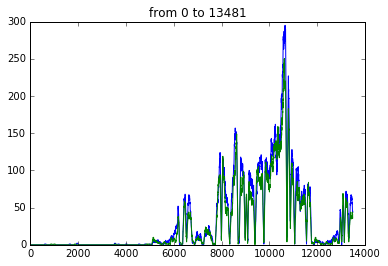

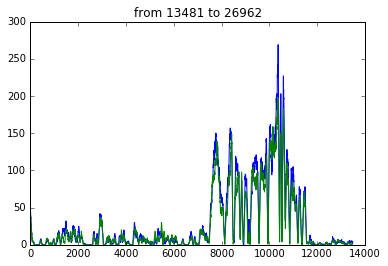

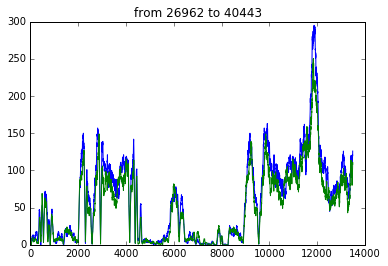

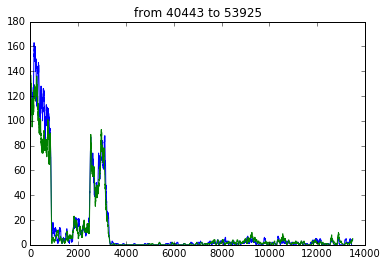

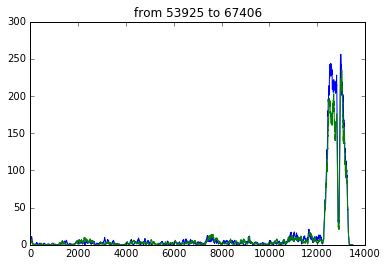

...

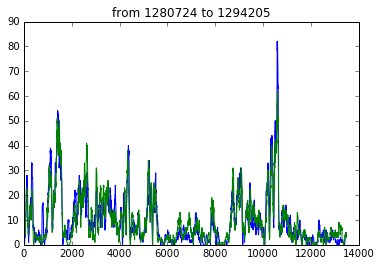

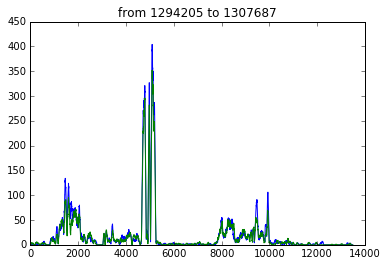

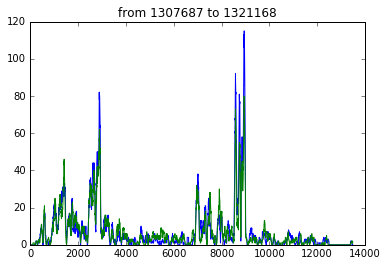

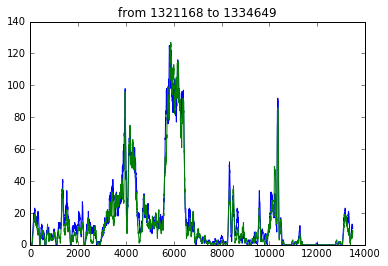

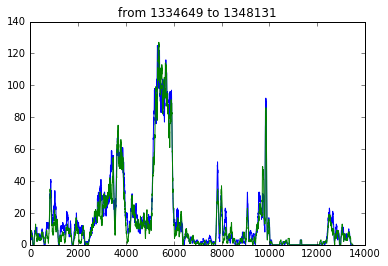

In [106]:
n = 100
length = len(reads1)

for i in range(n):
    idxlow = i*length/n
    idxhigh = (i+1) * length/n
    slice1 = reads1[idxlow : idxhigh]
    slice2 = reads2[idxlow : idxhigh]
    
    f, ax = plt.subplots()
    ax.plot(slice1)
    ax.plot(slice2)
    ax.set_title('from ' + str(idxlow) +' to ' + str(idxhigh))

## MAKEPLOTS(READSARRAY, NUMSPLITS)

#### Takes array of reads arrays (use np.stack((reads,reads,reads...))) and number of graphs to produce

In [158]:
def makeplots(readsarray, numsplits):
    length = len(readsarray[0])

    for i in range(numsplits):
        f, ax = plt.subplots()
        idxlow = i*length/numsplits
        idxhigh = (i+1) * length/numsplits
        
        for j in range(readsarray.shape[0]):
            sliced = readsarray[j][idxlow : idxhigh]
            ax.plot(sliced)
        ax.set_title('from ' + str(idxlow) +' to ' + str(idxhigh))

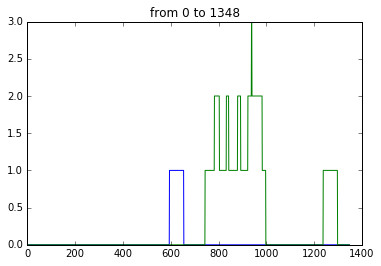

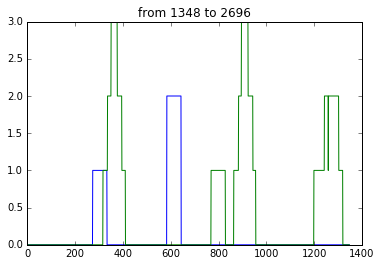

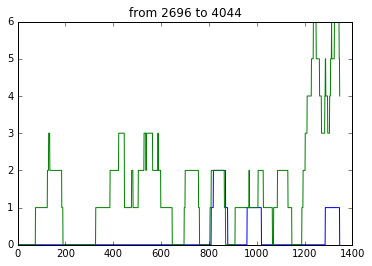

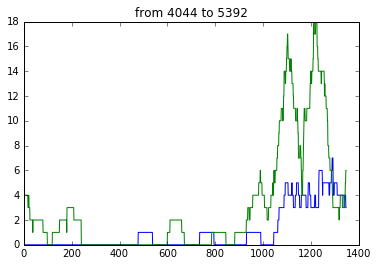

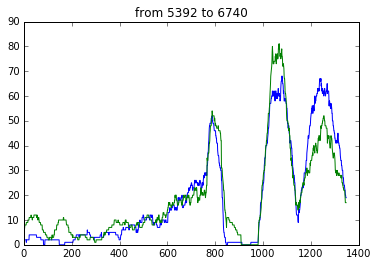

...

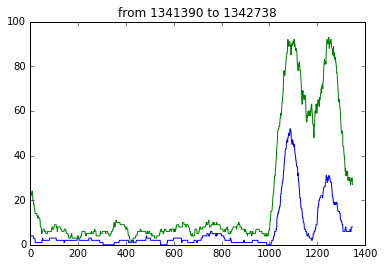

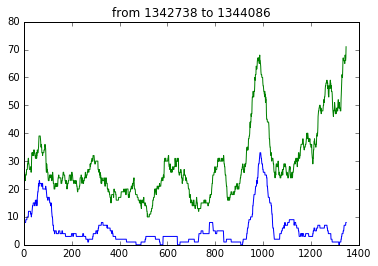

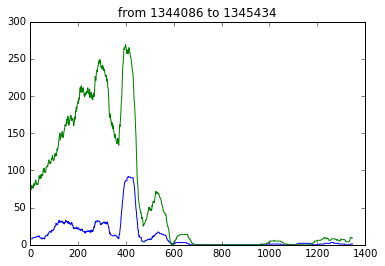

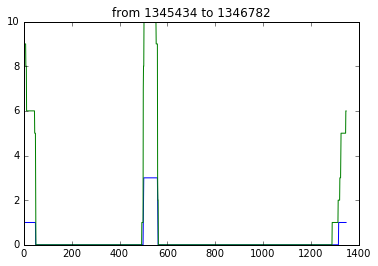

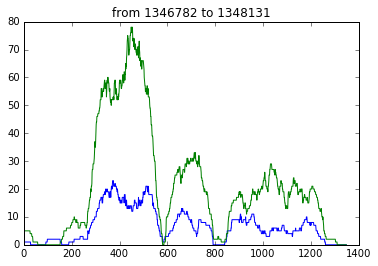

In [279]:
makeplots(np.stack((reads1,reads3)), 1000)

## DIFFERENTIAL EXPRESSION STUFF

In [179]:
def getdiffs(r1, r2, absolute = False ):
    if absolute == False:
        return np.subtract(r1,r2)
    else:
        return np.absolute(np.subtract(r1,r2))

(array([  3.68000000e+02,   1.87100000e+03,   1.07476900e+06,
          2.51094000e+05,   1.54950000e+04,   3.20100000e+03,
          7.71000000e+02,   3.74000000e+02,   1.44000000e+02,
          4.40000000e+01]),
 array([-170. , -109.7,  -49.4,   10.9,   71.2,  131.5,  191.8,  252.1,
         312.4,  372.7,  433. ]),
 <a list of 10 Patch objects>)

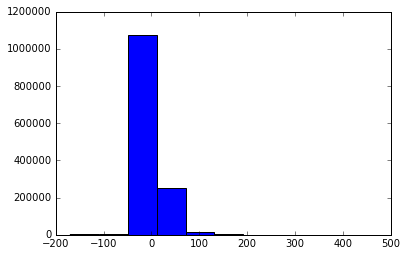

In [184]:
plt.hist(getdiffs(reads1, reads2))

(array([  1.28984300e+06,   4.43560000e+04,   9.10000000e+03,
          3.03300000e+03,   8.66000000e+02,   4.27000000e+02,
          2.69000000e+02,   1.59000000e+02,   5.30000000e+01,
          2.50000000e+01]),
 array([   0. ,   43.3,   86.6,  129.9,  173.2,  216.5,  259.8,  303.1,
         346.4,  389.7,  433. ]),
 <a list of 10 Patch objects>)

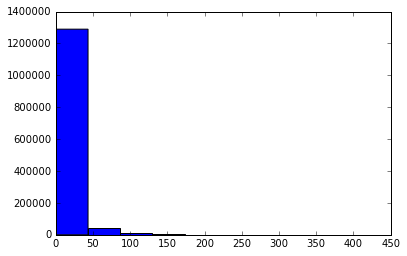

In [185]:
plt.hist(getdiffs(reads1, reads2, absolute = True))

## POSSIBLE PLAN

Import ALL h5py readfiles for a given chromosome,
then create a new array vars_by_idx --- an array that is the length of the chromosome, 
where each index has stored the variance in reads across all samples

Not sure how to decide if reps can be combined

## ANNOTATIONS STUFF

In [275]:
annotations = h5py.File('../ALIGNMENTDATA/h5py_compressed/dm6_annotations/chr4.h5','r')
annos = annotations.get('1000')[()]
annos

array([['CDS', 'FBtr0346692.1'],
       ['exon', 'FBtr0346692.1']], 
      dtype='|S13')

In [281]:
anno.size

AttributeError: 'File' object has no attribute 'size'

In [ ]:
## NONCODING IF IS EMPTY ARRAY AT INDEX?????

In [238]:
chromslen = h5py.File('../ALIGNMENTDATA/h5py_compressed/CHROMS_LEN.h5','r')

In [239]:
chromslen.get('chr4')[()]


1348131

In [273]:
def codingstatus(chrom, idx):
    if chrom == 'chr4':
        if idx < chromslen.get('chr4')[()]:
            # Checks to see if there are any annotations stored at that index
            if annotations.get(str(idx))[()].size == 0:
                return 'noncoding'
            else:
                return 'coding'
        else:
            return 'out of range'
    else:
        return 'code incomplete'
            

In [280]:
codingstatus('chr4', 397698)

TypeError: 'NoneType' object has no attribute '__getitem__'

In [282]:
annos = annotations.get('397698')[()]


TypeError: 'NoneType' object has no attribute '__getitem__'